In [2]:
# Installing nibabel
!pip install nibabel

# Importing
import numpy as np
import tensorflow as tf
from tensorflow import keras
from keras import layers, Sequential
from keras.layers import *
import matplotlib.pyplot as plt
from matplotlib import image
import os
import nibabel as nib
import pandas as pd
import scipy
from scipy import ndimage
from PIL import Image
from sklearn.model_selection import train_test_split
#from google.colab import drive
#drive.mount('/content/drive')

In [164]:
#os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [2]:
adDir = r'C:\Users\Ch1ck\Desktop\AD'
nonAdDir = r'C:\Users\Ch1ck\Desktop\NonAD'

In [7]:
def resize_img(img):

    # Desired sizes
    desired_depth = 256

    # Get current sizes
    current_depth = img.shape[2]

    # Resize factors
    depth = current_depth / desired_depth
    depth_factor = 1 / depth

    # Resizing
    img = ndimage.zoom(img, (1, 1, depth_factor), order=1)
    return img

In [8]:
def resize_img2D(img):

    # Desired sizes
    desired_width = 128
    desired_height = 128

    # Get current sizes
    current_width = img.shape[0]
    current_height = img.shape[1]

    # Resize factors
    width = current_width / desired_width
    height = current_height / desired_height

    width_factor = 1 / width
    height_factor = 1 / height


    # Resizing
    img = ndimage.zoom(img, (width_factor, height_factor), order=1)
    return img

In [9]:
def crop_img(img):
  for side in range(4):
    for location in range(128): # Iterate through 128: l/w of image
      if (img[location,:].max() > img[:,:].mean()): # if the array at given slice
      
        img = img[location:,:]
        zero = np.zeros((25, img.shape[1]))
        img = np.concatenate([zero, img], axis = 0)
        img = np.rot90(img)
        break

  img = resize_img2D(img)
  return img.reshape(128,128,1)

In [67]:
#reading in the demented dataset
scans = [
    os.path.join(adDir, x)
    for x in os.listdir(adDir)]

images = []
for imgs in scans:
    images.append(np.array(nib.load(imgs).dataobj))

In [ ]:
del images[11]
del images[4]
del images[1]
del images[0]

In [79]:
# Resizing depth
resized_imgs = []
for imgs in images:
    resized_imgs.append(resize_img(imgs))

0


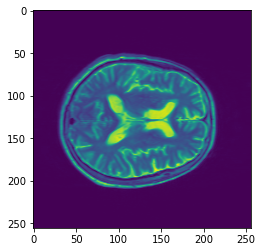

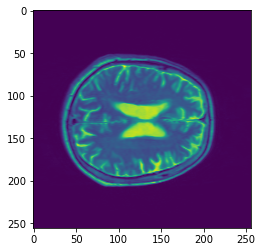

1


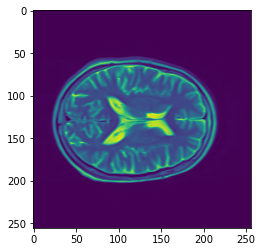

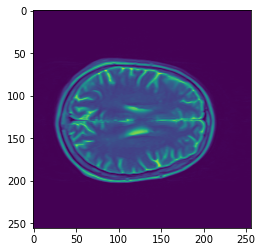

2


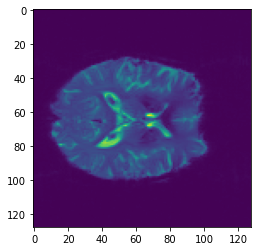

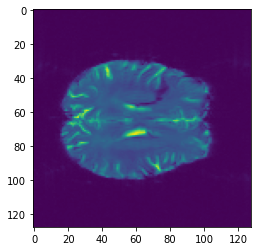

3


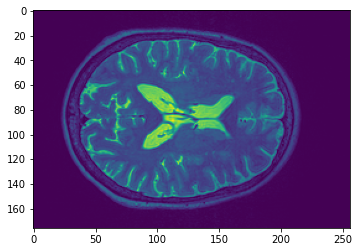

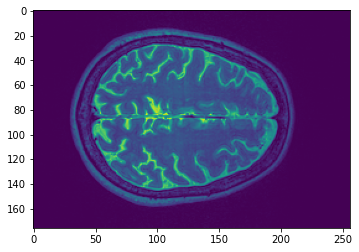

4


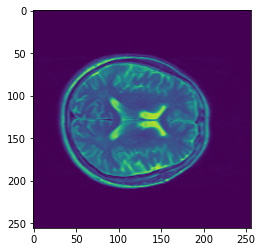

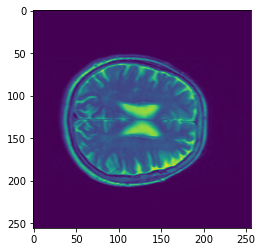

5


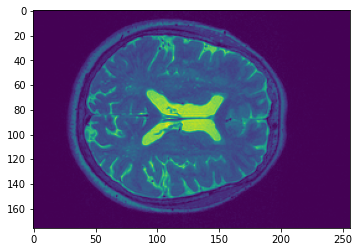

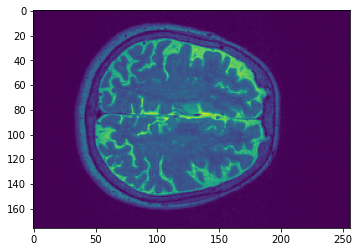

6


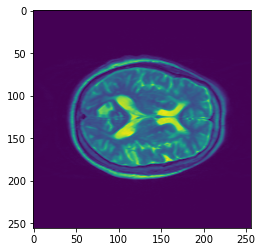

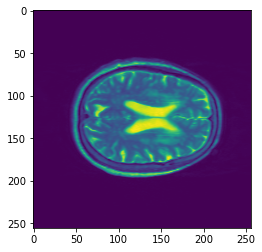

7


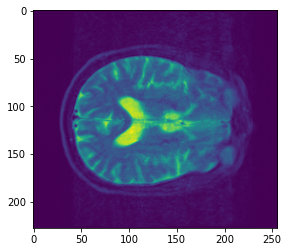

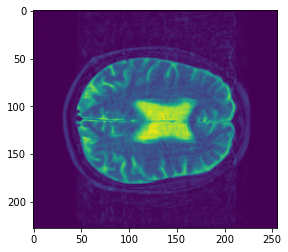

8


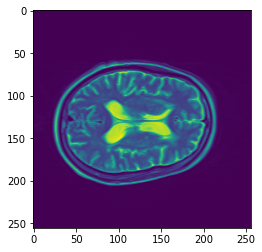

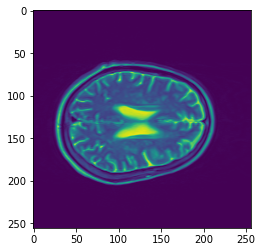

9


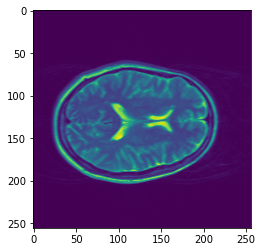

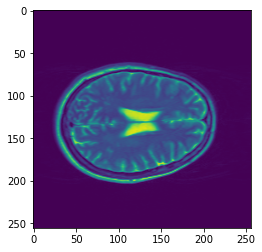

10


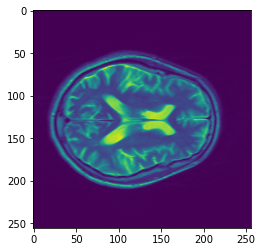

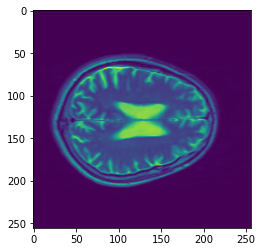

In [81]:
# Display ranges
for i in range(len(resized_imgs)):
    print(i)
    plt.imshow(resized_imgs[i][:,:,140])
    plt.show()
    plt.imshow(resized_imgs[i][:,:,160])
    plt.show()

In [ ]:
"""
-0: 140-160
-1: 135-155
2: remove
-3: 135-145
-4: 140-160
-5 140-150
-6: 140-160
-7: 145-160
-8: 140-160
-9: 145-160
-10: 140-160
"""

In [92]:
# List of good data
good_slices = []
for i in range(140,160):
    good_slices.append(resized_imgs[0][:,:,i])
    good_slices.append(resized_imgs[4][:,:,i])
    good_slices.append(resized_imgs[6][:,:,i])
    good_slices.append(resized_imgs[8][:,:,i])
    good_slices.append(resized_imgs[10][:,:,i])
    
for i in range(145,160):
    good_slices.append(resized_imgs[7][:,:,i])
    good_slices.append(resized_imgs[9][:,:,i])
    
for i in range(135,155):
    good_slices.append(resized_imgs[1][:,:,i])
    
for i in range(135,145):
    good_slices.append(resized_imgs[3][:,:,i])
    
for i in range(140,150):
    good_slices.append(resized_imgs[5][:,:,i])

In [95]:
# Crop and Buffer Slices
ad_slices = []
for slices in good_slices:
    ad_slices.append(crop_img(slices))

In [96]:
print(len(ad_slices))
print(ad_slices[0].shape)
print(len(scans))

170
(128, 128, 1)
14


0


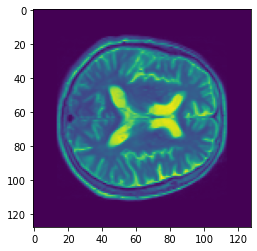

1


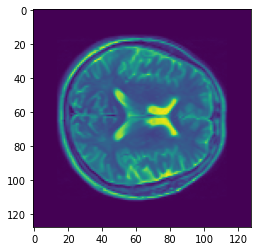

2


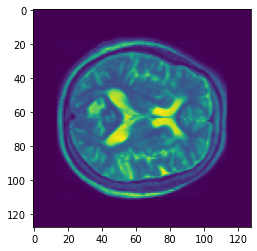

3


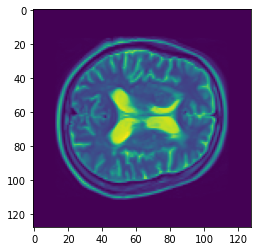

4


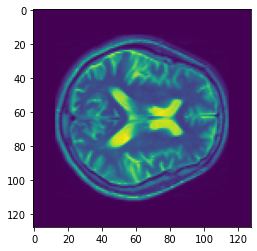

5


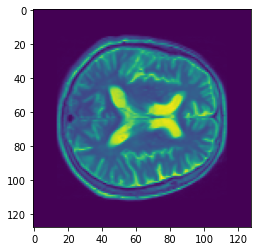

6


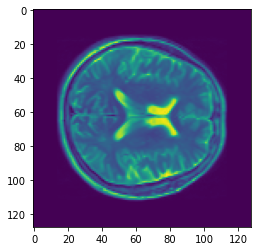

7


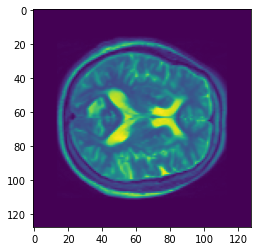

8


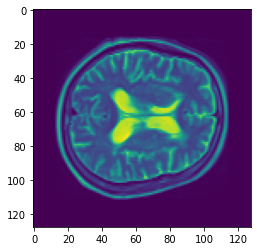

9


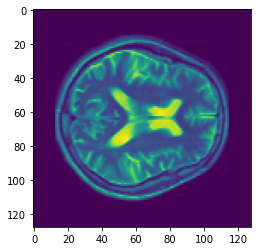

10


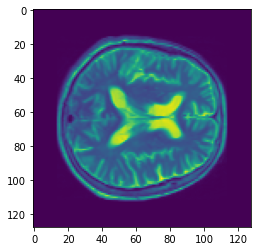

11


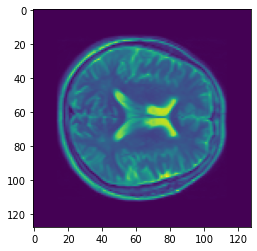

12


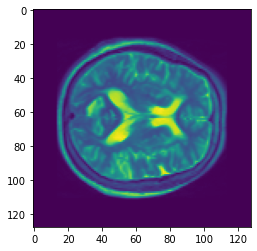

13


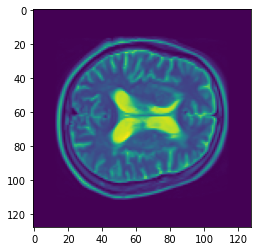

14


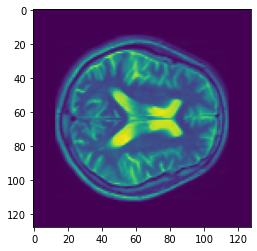

15


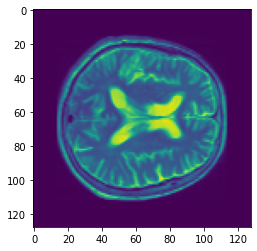

16


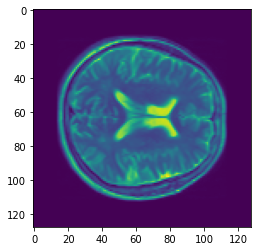

17


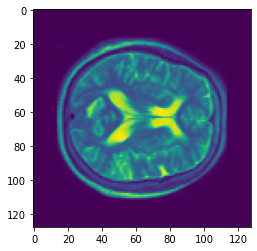

18


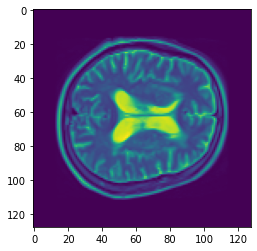

19


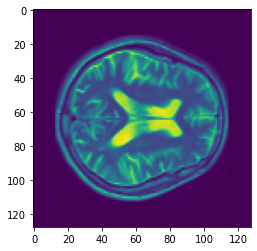

20


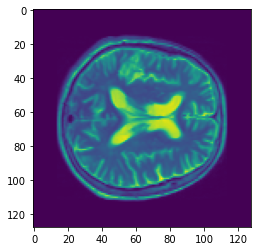

21


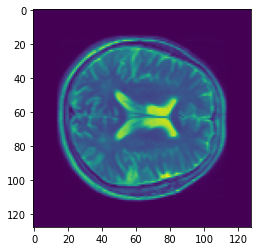

22


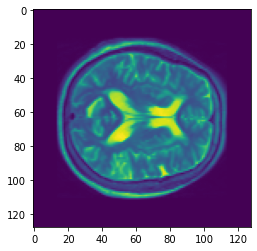

23


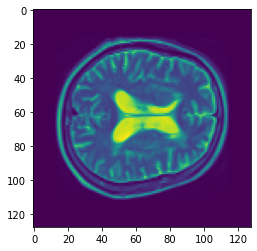

24


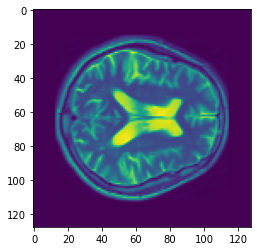

25


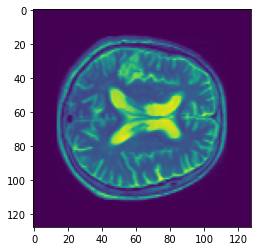

26


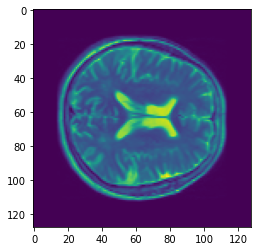

27


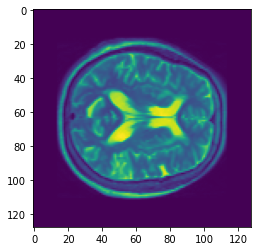

28


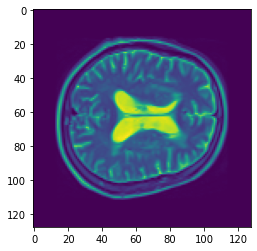

29


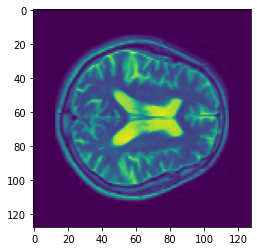

30


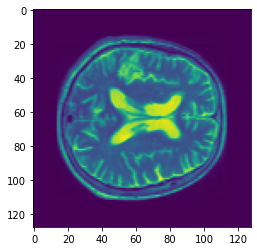

31


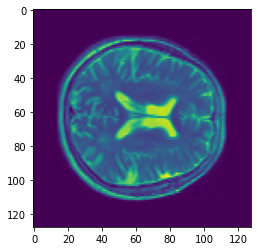

32


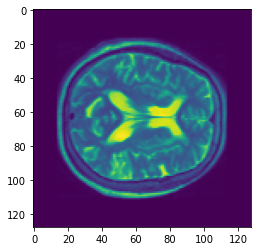

33


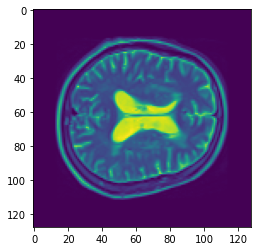

34


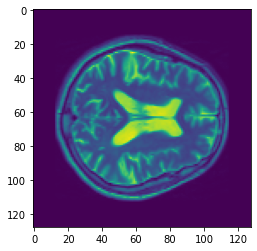

35


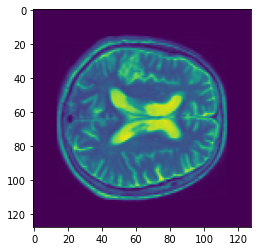

36


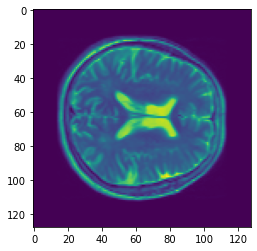

37


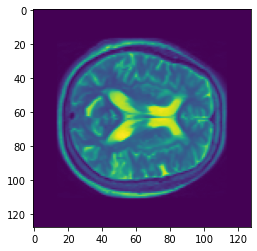

38


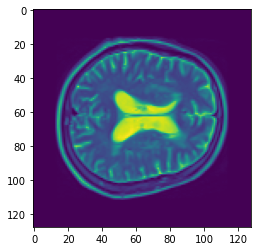

39


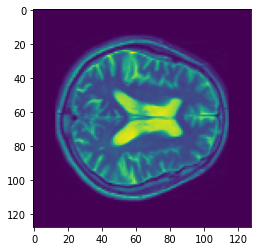

40


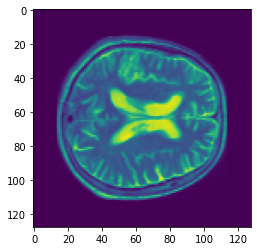

41


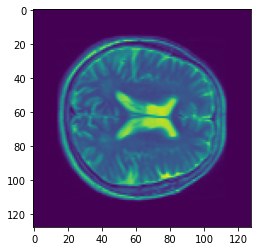

42


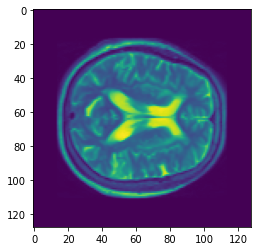

43


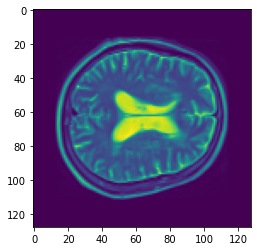

44


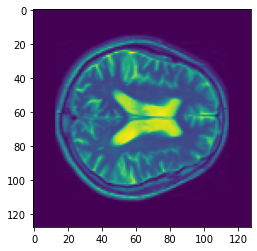

45


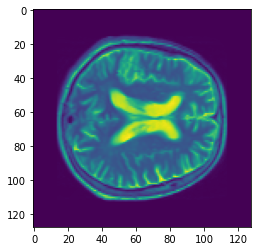

46


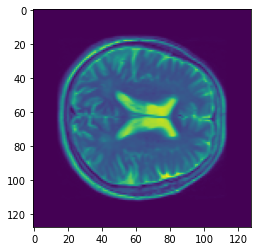

47


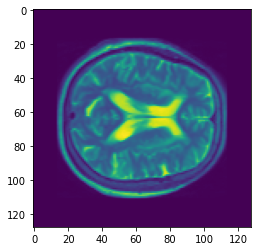

48


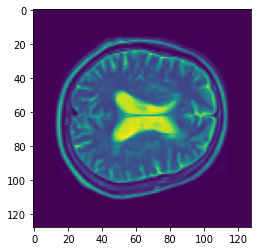

49


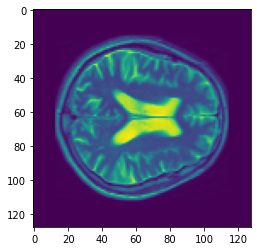

50


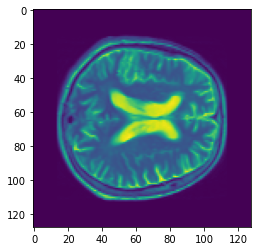

51


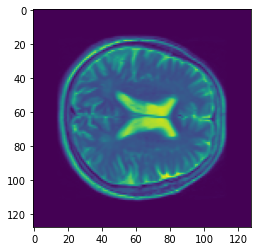

52


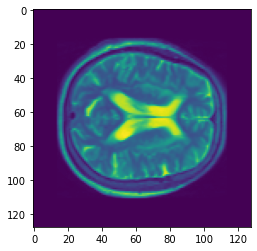

53


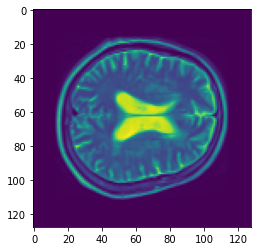

54


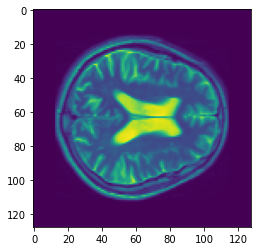

55


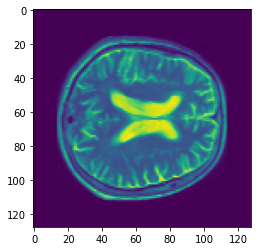

56


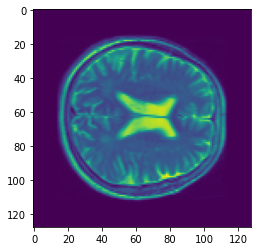

57


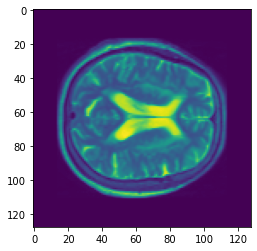

58


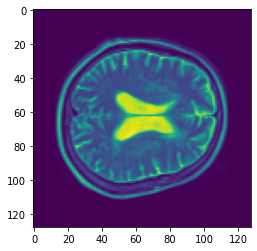

59


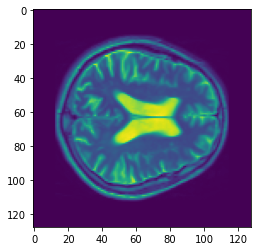

60


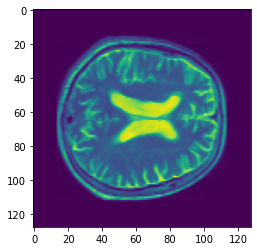

61


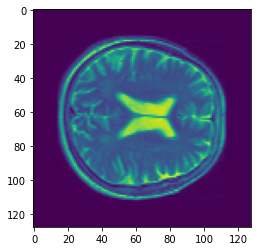

62


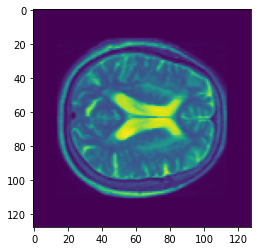

63


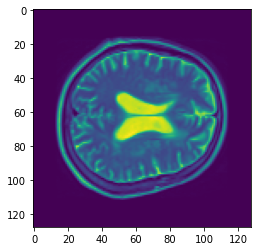

64


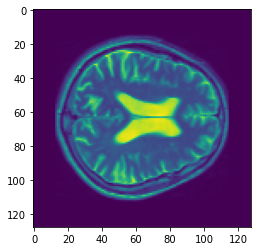

65


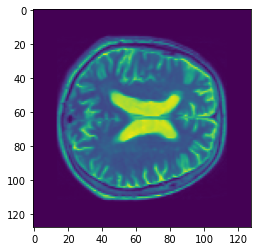

66


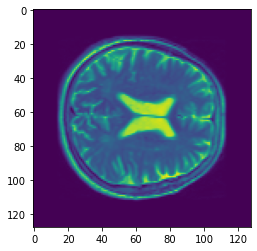

67


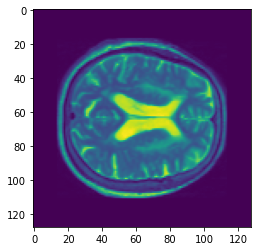

68


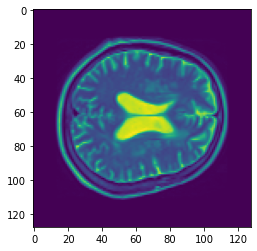

69


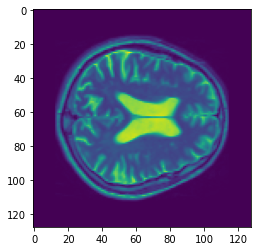

70


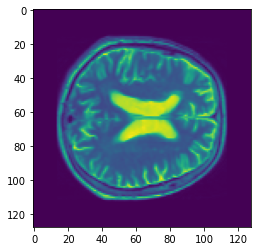

71


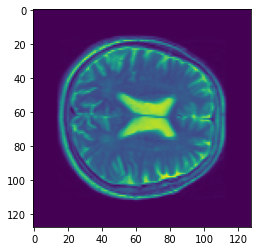

72


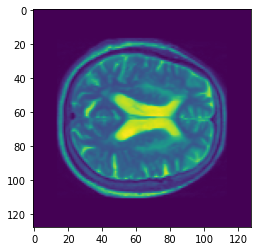

73


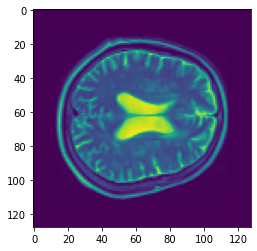

74


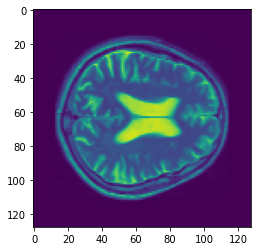

75


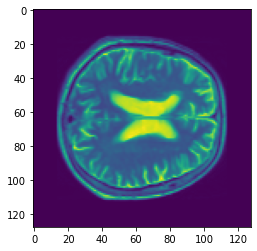

76


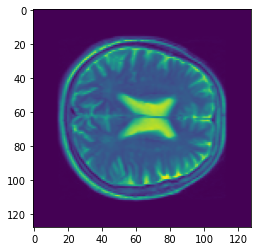

77


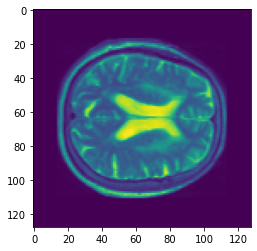

78


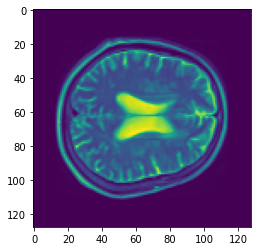

79


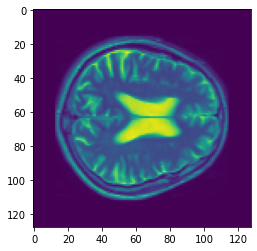

80


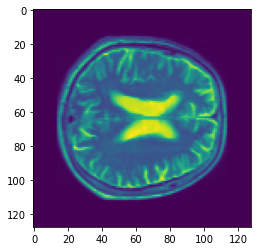

81


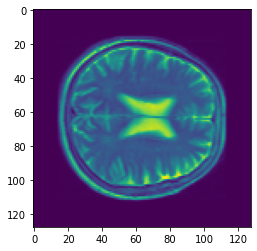

82


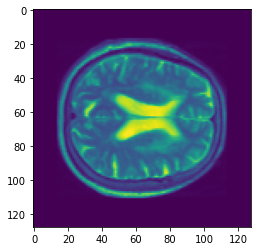

83


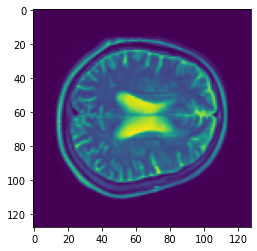

84


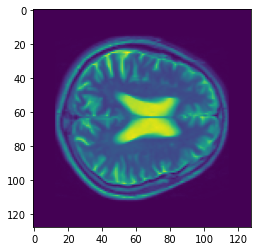

85


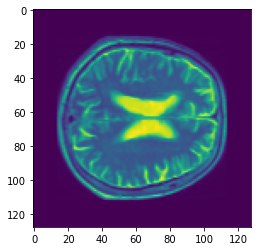

86


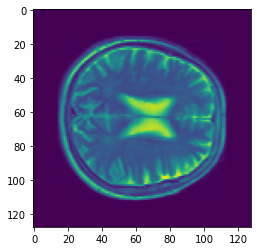

87


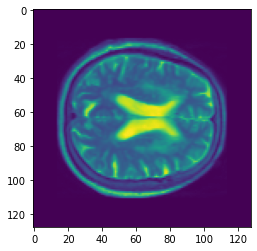

88


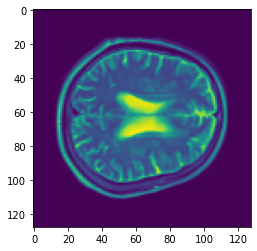

89


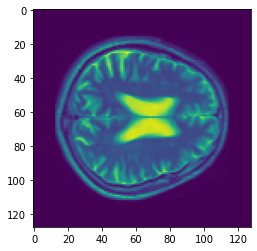

90


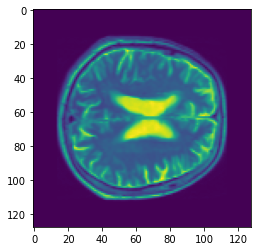

91


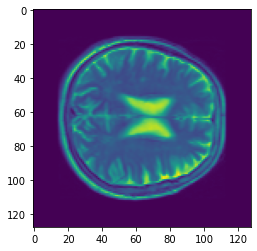

92


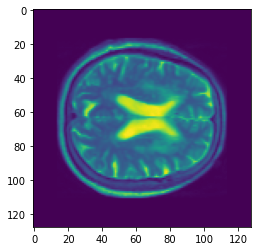

93


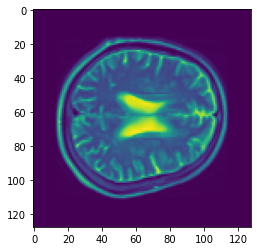

94


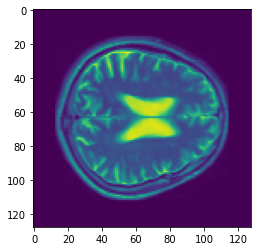

95


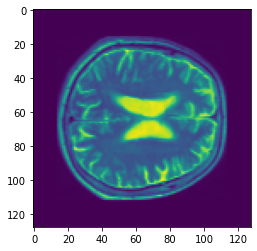

96


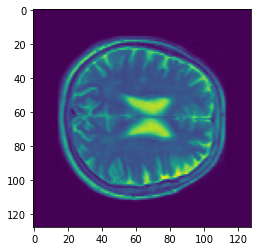

97


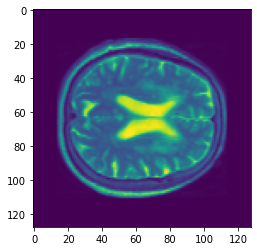

98


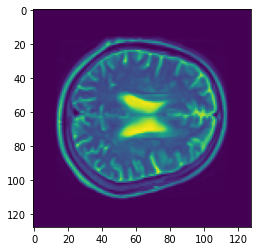

99


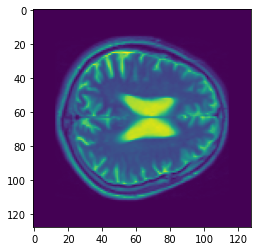

100


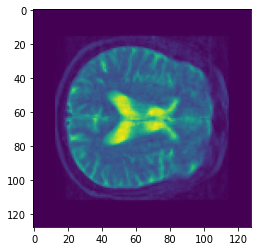

101


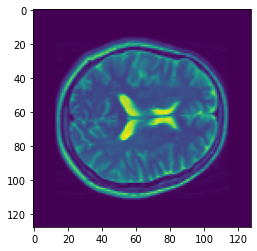

102


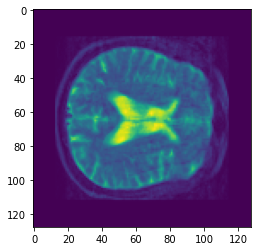

103


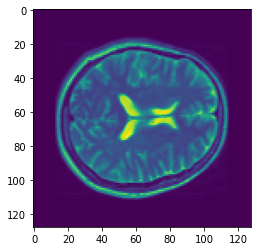

104


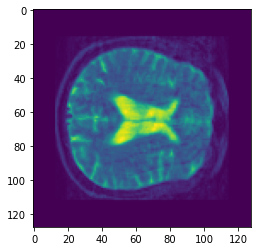

105


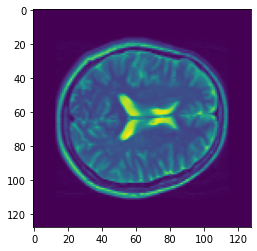

106


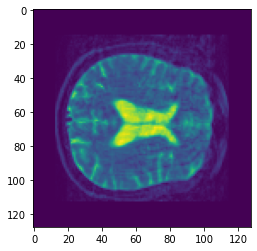

107


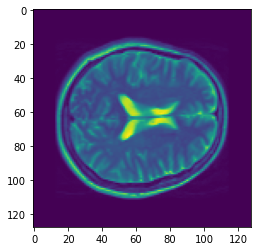

108


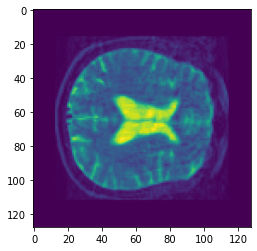

109


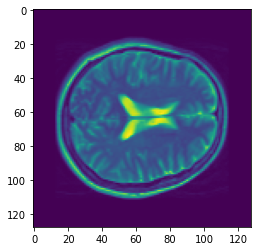

110


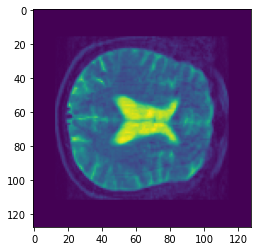

111


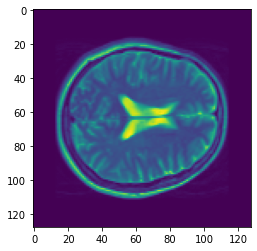

112


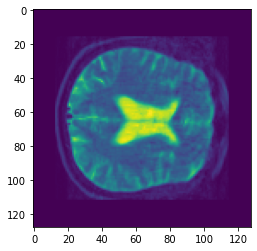

113


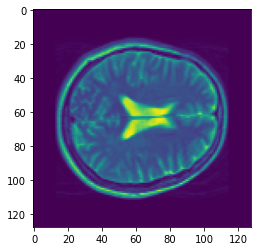

114


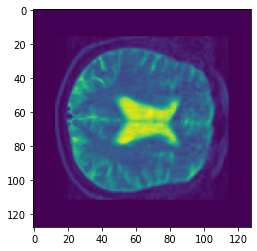

115


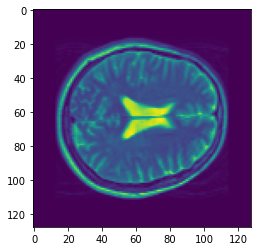

116


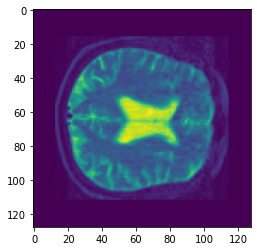

117


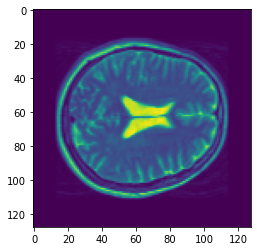

118


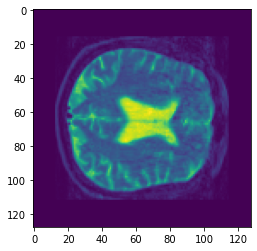

119


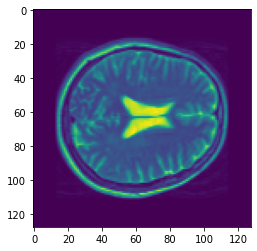

120


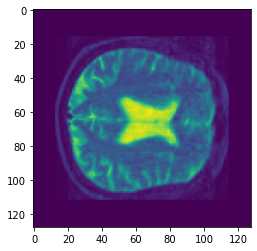

121


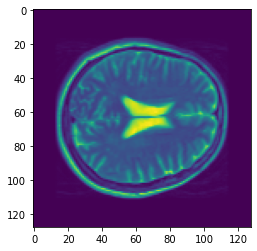

122


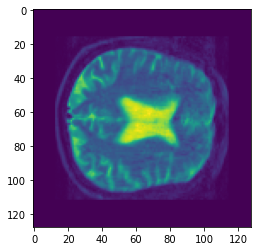

123


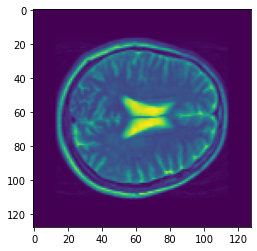

124


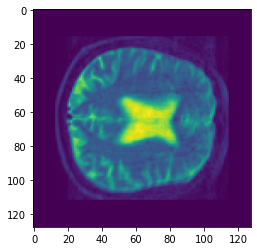

125


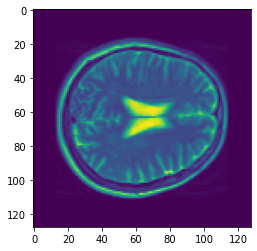

126


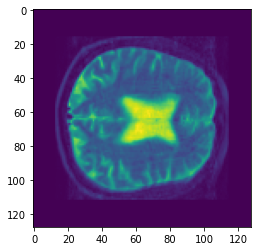

127


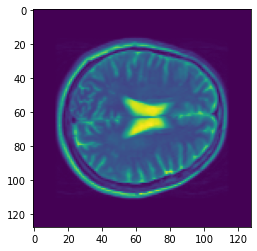

128


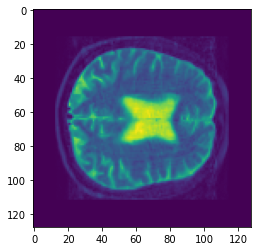

129


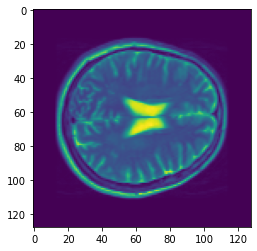

130


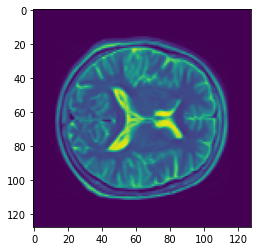

131


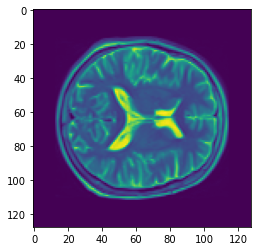

132


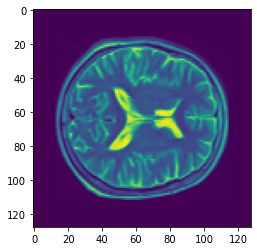

133


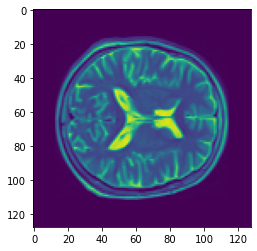

134


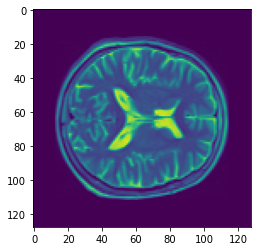

135


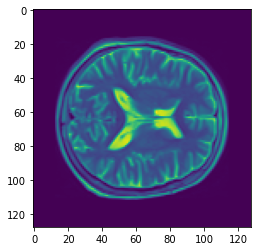

136


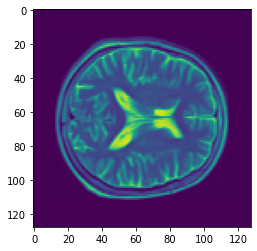

137


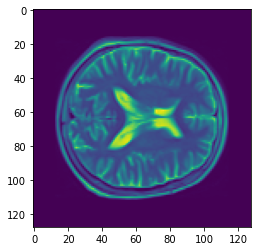

138


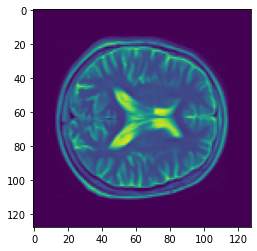

139


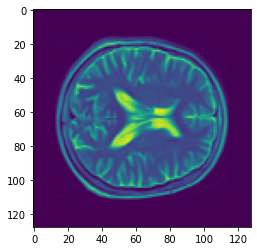

140


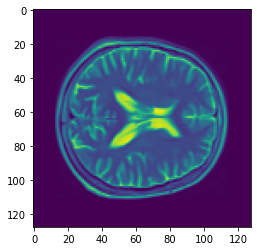

141


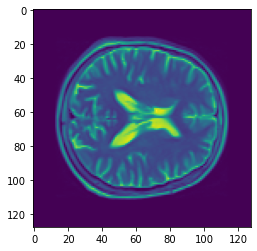

142


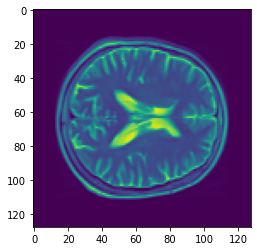

143


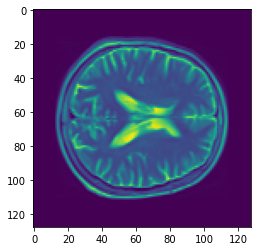

144


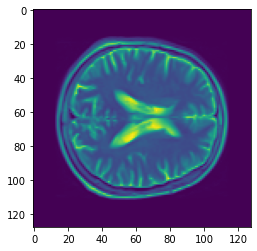

145


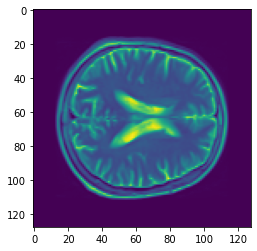

146


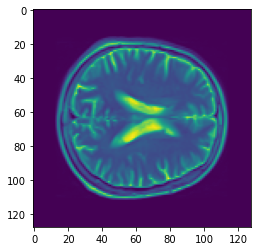

147


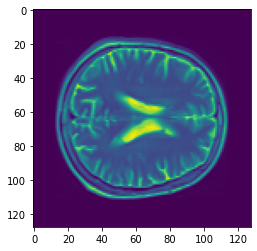

148


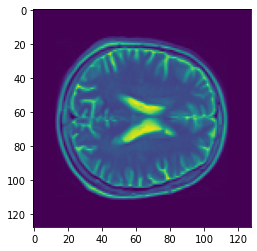

149


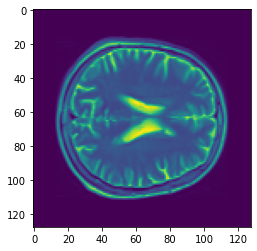

150


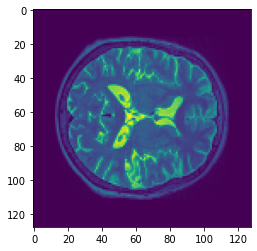

151


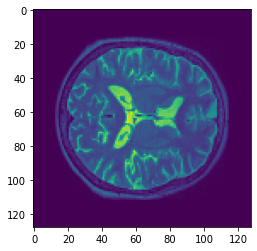

152


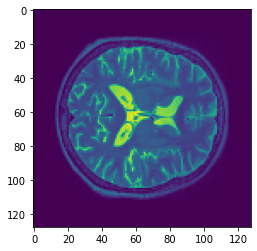

153


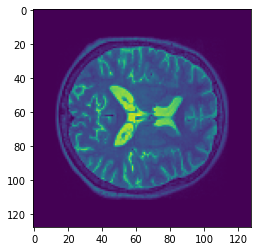

154


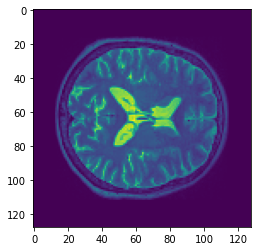

155


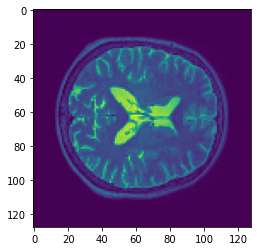

156


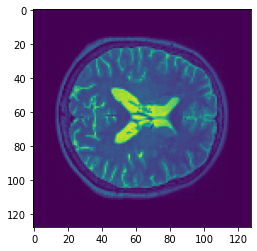

157


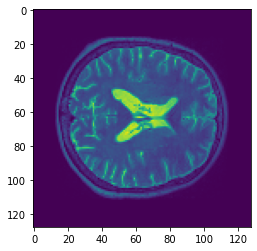

158


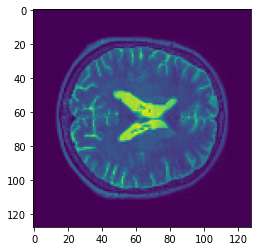

159


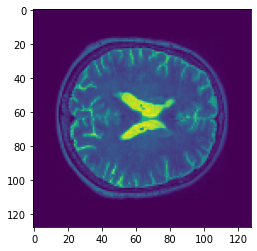

160


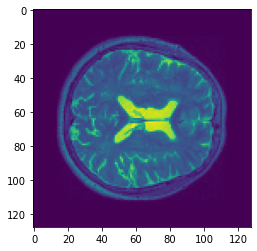

161


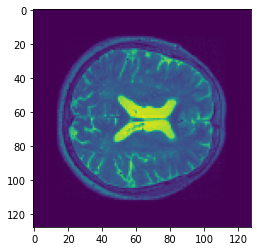

162


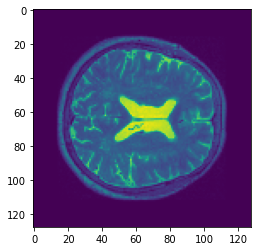

163


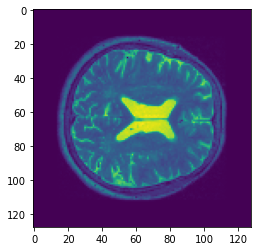

164


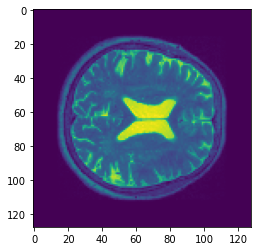

165


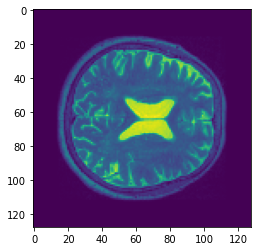

166


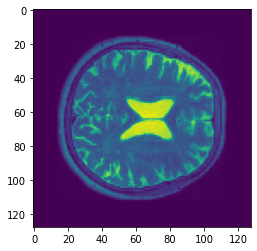

167


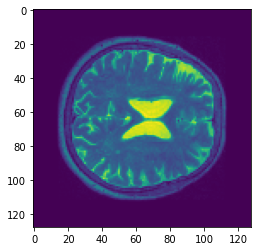

168


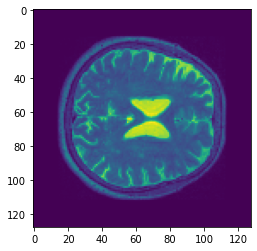

169


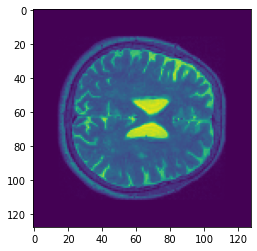

In [97]:
# Display Images
for i in range(len(ad_slices)):
    print(i)
    plt.imshow(ad_slices[i])
    plt.show()

In [98]:
np.savez_compressed(adDir + '\\adSlices',ad_slices)

In [145]:
np.save(adDir + '\\adSlices', ad_slices)

In [99]:
#reading in the normal scans
scans = [
    os.path.join(nonAdDir, x)
    for x in os.listdir(nonAdDir)
]

images = []
for imgs in scans:
    images.append(np.array(nib.load(imgs).dataobj))

In [100]:
# Resizing depth
resized_imgs = []
for imgs in images:
    resized_imgs.append(resize_img(imgs))

In [104]:
# Slices
non_slices = []
for imgs in resized_imgs:
    for i in range (140, 160, 5):
        non_slices.append(crop_img(imgs[:,:,i]))

In [105]:
print(len(non_slices))

76


0


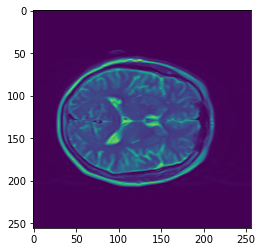

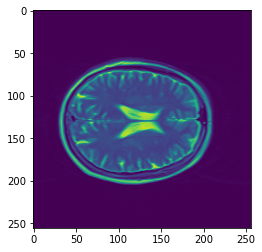

1


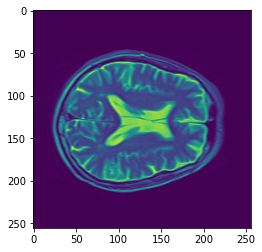

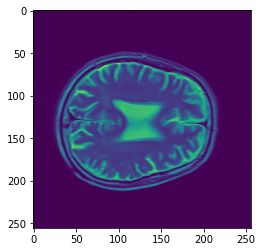

2


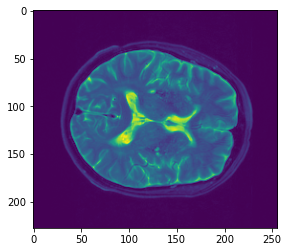

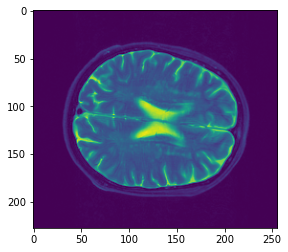

3


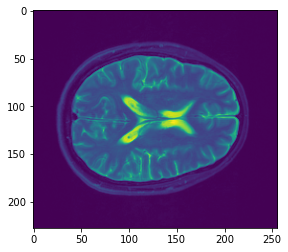

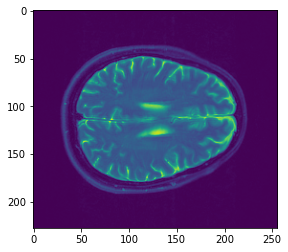

4


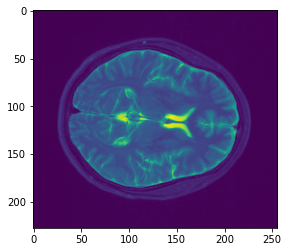

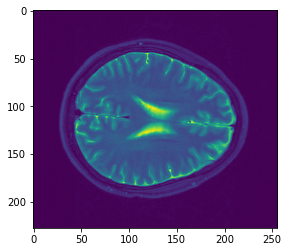

5


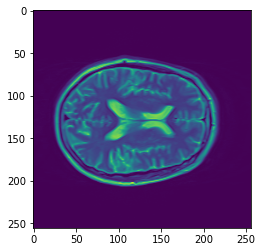

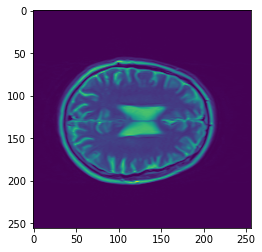

6


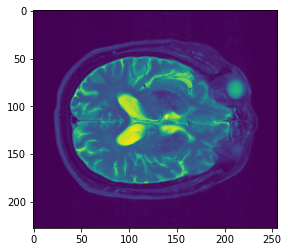

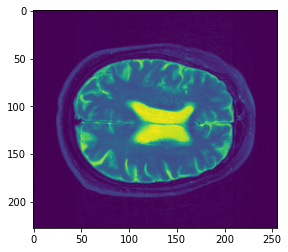

7


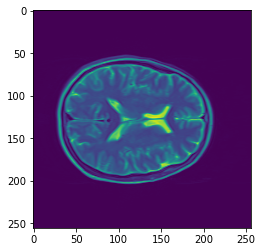

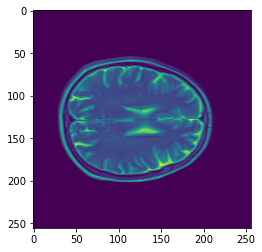

8


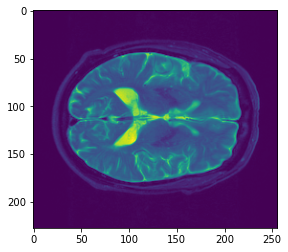

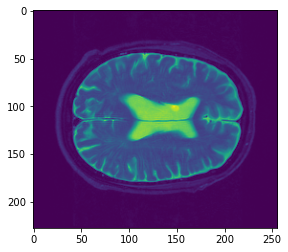

9


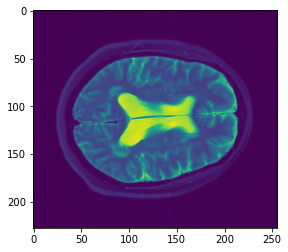

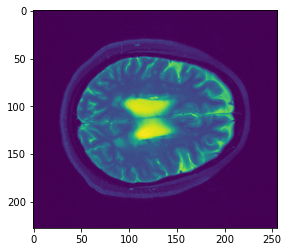

10


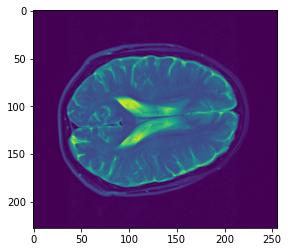

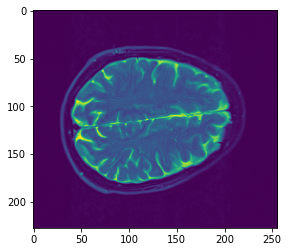

11


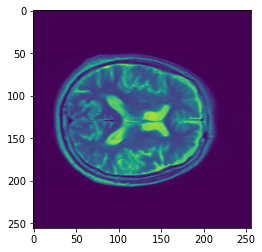

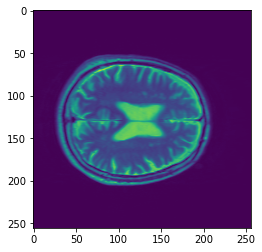

12


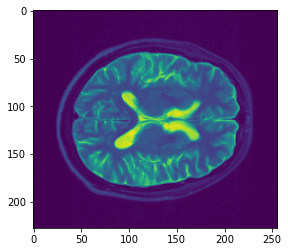

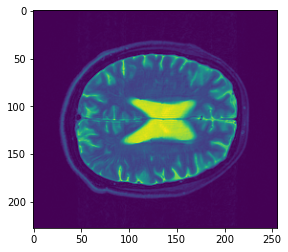

13


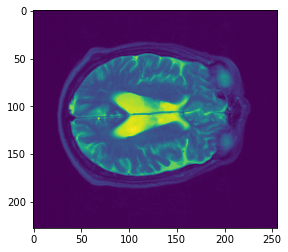

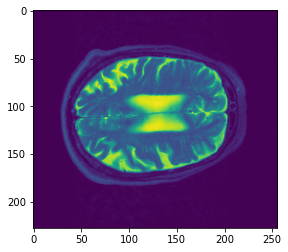

14


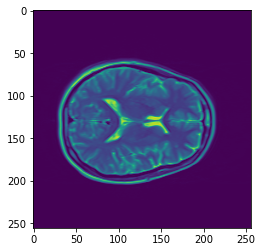

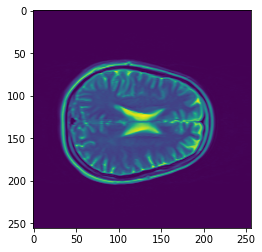

15


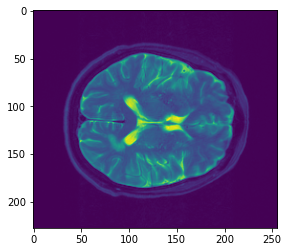

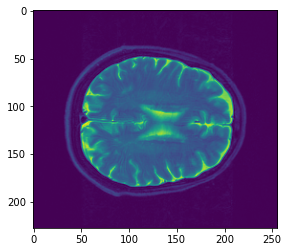

16


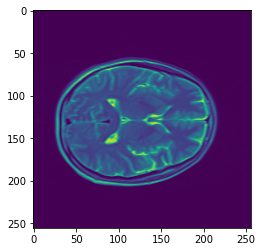

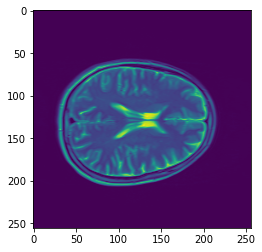

17


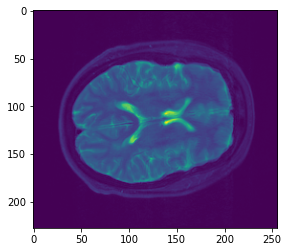

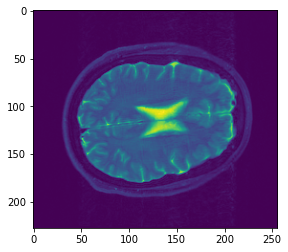

18


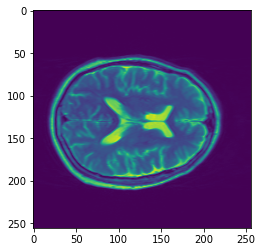

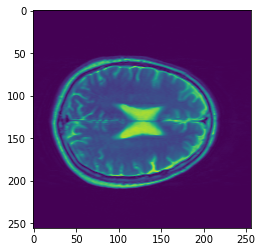

In [107]:
for i in range(len(resized_imgs)):
    print(i)
    plt.imshow(resized_imgs[i][:,:,140])
    plt.show()
    plt.imshow(resized_imgs[i][:,:,160])
    plt.show()

140


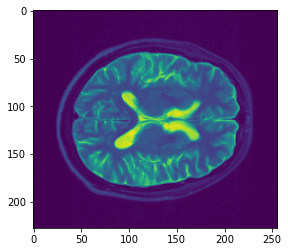

141


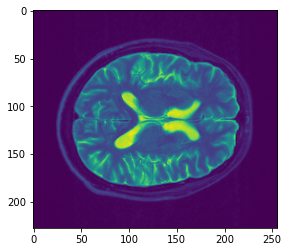

142


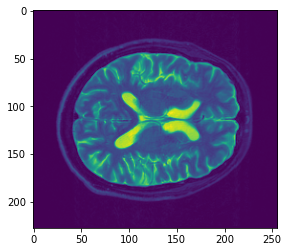

143


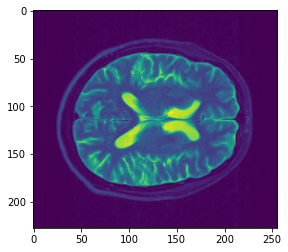

144


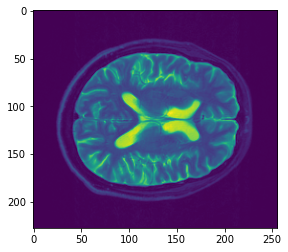

145


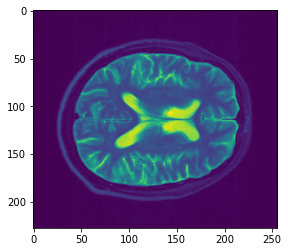

146


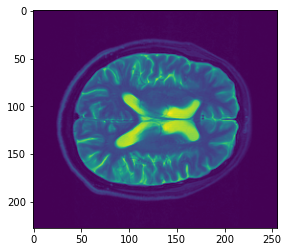

147


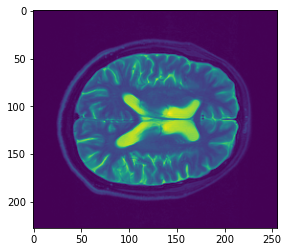

148


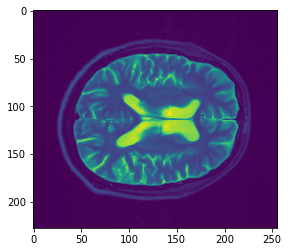

149


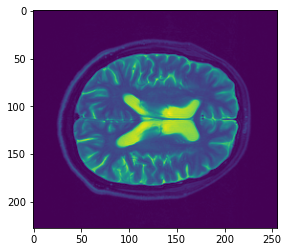

150


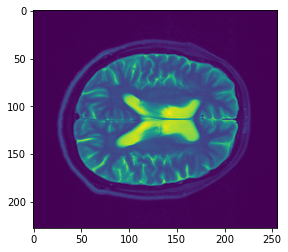

151


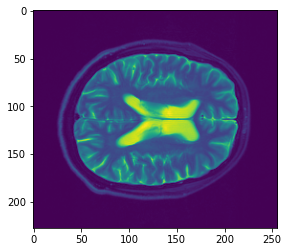

152


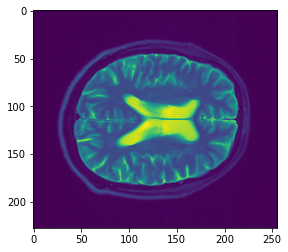

153


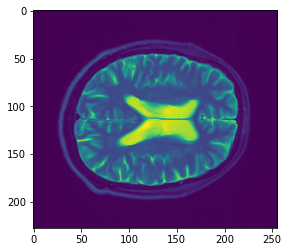

154


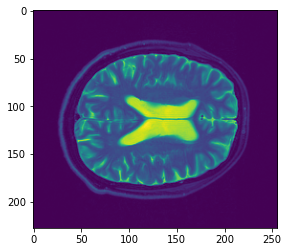

155


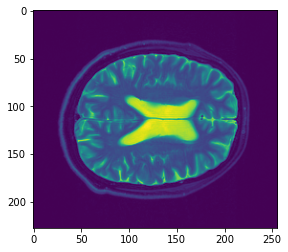

156


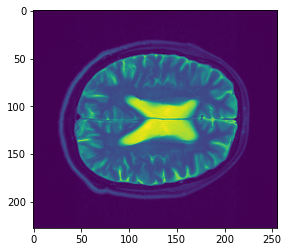

157


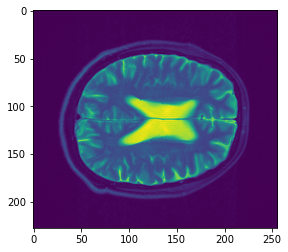

158


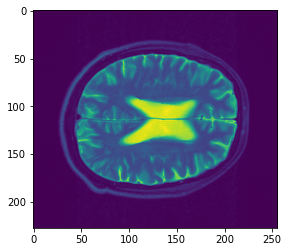

159


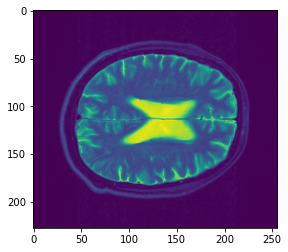

In [139]:
for i in range(140, 160):
    print(i)
    plt.imshow(resized_imgs[12][:,:,i])
    plt.show()

In [ ]:
'''
`0: 153-163
`1: 140-160
`2: 140-160
`3: 140-150
4: XXXX
`5: 140-160
`6: 145-165
`7: 145-150
`8: 151-160
`9: 138-155
10: XXXX
`11:140-160
`12:140-160
'''

In [140]:
good_slices = []
for i in range(140,160):
    good_slices.append(resized_imgs[1][:,:,i])
    good_slices.append(resized_imgs[2][:,:,i])
    good_slices.append(resized_imgs[5][:,:,i])
    good_slices.append(resized_imgs[11][:,:,i])
    good_slices.append(resized_imgs[12][:,:,i])
    
for i in range(153,163):
    good_slices.append(resized_imgs[0][:,:,i])
    
for i in range(140,150):
    good_slices.append(resized_imgs[3][:,:,i])
    
for i in range(145,165):
    good_slices.append(resized_imgs[6][:,:,i])
    
for i in range(145,150):
    good_slices.append(resized_imgs[7][:,:,i])
    
for i in range(151,160):
    good_slices.append(resized_imgs[8][:,:,i])
    
for i in range(138,155):
    good_slices.append(resized_imgs[9][:,:,i])

In [141]:
# Crop and Buffer Slices
non_slices = []
for slices in good_slices:
    non_slices.append(crop_img(slices))

In [142]:
print(len(non_slices))

171


In [144]:
np.savez_compressed(nonAdDir + '\\nonSlices',non_slices)

In [146]:
np.save(nonAdDir + '\\nonSlices', non_slices)

In [239]:
file = r'C:\Users\Ch1ck\Desktop\sub-OAS30065_sess-d0548_acq-TSE_T2w.nii'
saveThis = np.array(nib.load(file).dataobj)

In [240]:
saveThisNon = resize_img(saveThis)
len(saveThisNon)

256

140


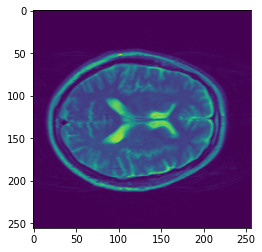

141


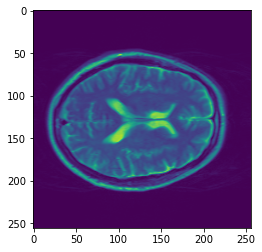

142


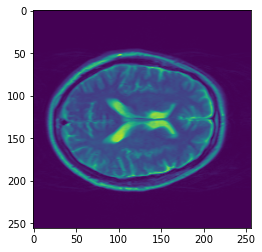

143


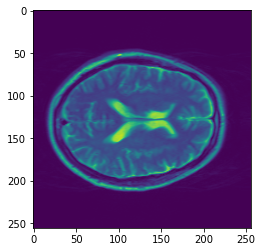

144


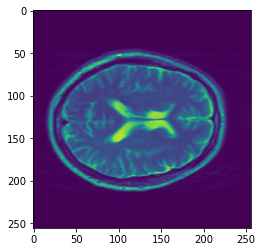

145


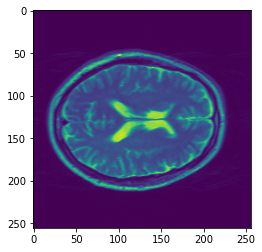

146


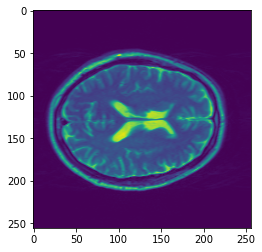

147


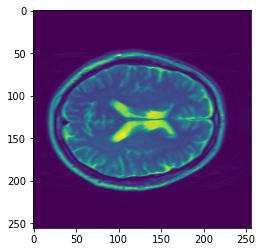

148


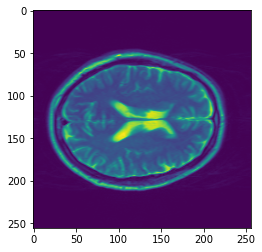

149


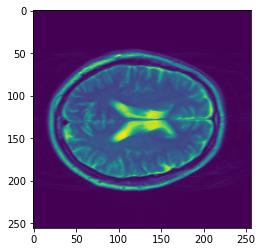

150


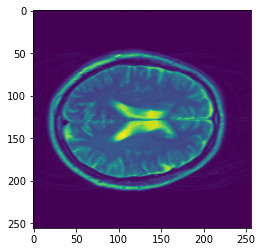

151


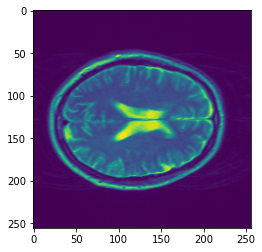

152


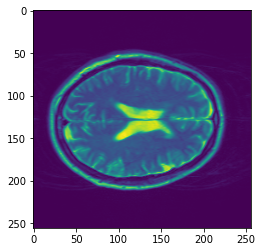

153


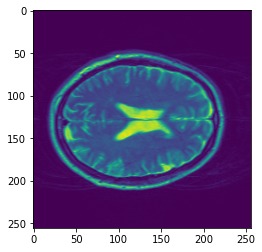

154


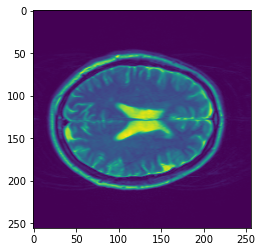

155


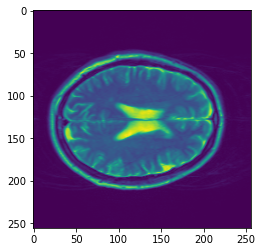

156


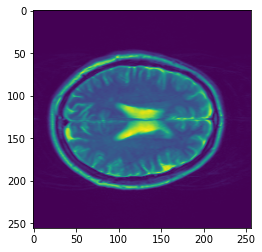

157


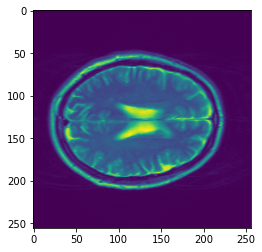

158


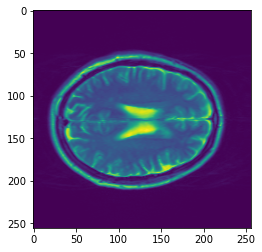

159


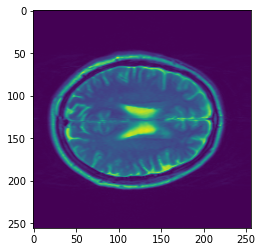

In [241]:
for i in range(140, 160):
    print(i)
    plt.imshow(saveThisNon[:,:,i])
    plt.show()

In [242]:
saveNon = []
for i in range(140, 160):
    saveNon.append(saveThisNon[:,:,i])

In [225]:
len(saveNon)

20

In [227]:
crop_saveNon = []
for i in range(len(saveNon)):
    crop_saveNon.append(crop_img(saveNon[i]))

In [228]:
len(crop_saveNon)

20

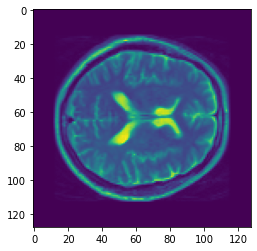

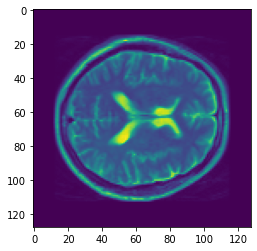

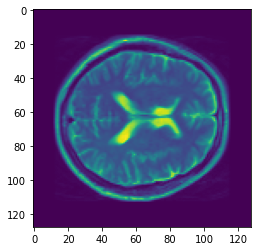

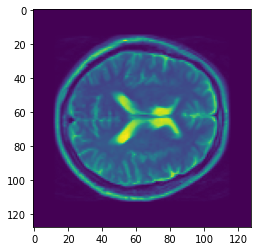

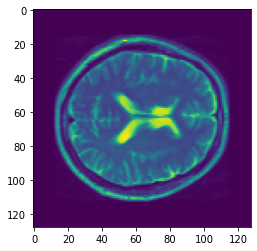

...

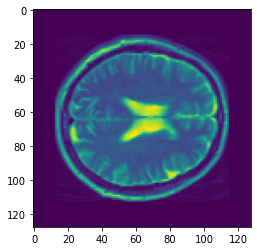

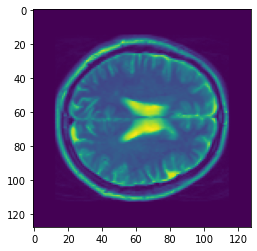

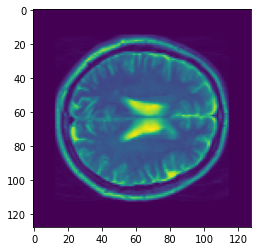

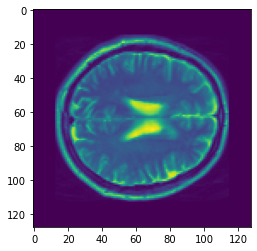

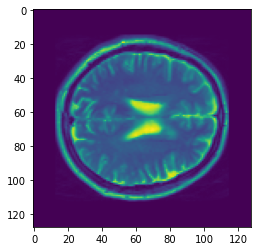

In [243]:
for i in range(len(crop_saveNon)):
    plt.imshow(crop_saveNon[i])
    plt.show()

In [244]:
np.save(r'C:\Users\Ch1ck\Desktop\nonValidation', crop_saveNon)

In [247]:
file2 = r'C:\Users\Ch1ck\Desktop\sub-OAS30094_sess-d0679_acq-TSE_run-01_T2w.nii'
saveThis2 = np.array(nib.load(file2).dataobj)
saveThis2 = resize_img(saveThis2)

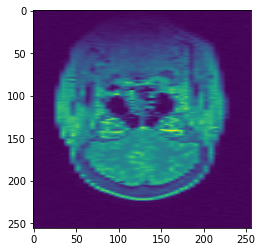

In [269]:
plt.imshow(saveThis2[90,:,:])

In [248]:
file3 = r'C:\Users\Ch1ck\Desktop\sub-OAS30095_sess-d0033_acq-TSE_T2w.nii'
saveThis3 = np.array(nib.load(file3).dataobj)
saveThis3 = resize_img(saveThis3)

130


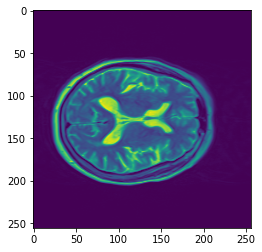

131


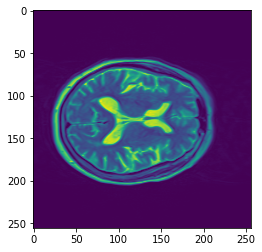

132


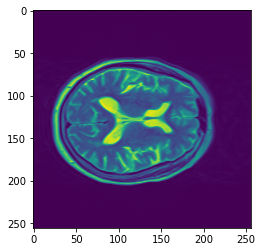

133


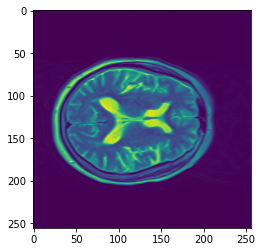

134


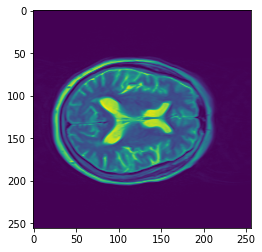

135


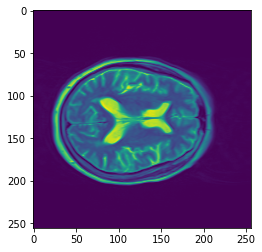

136


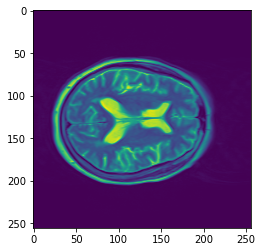

137


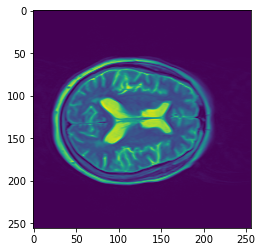

138


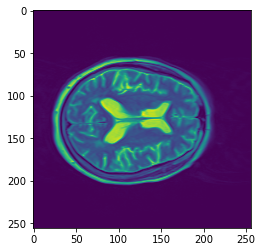

139


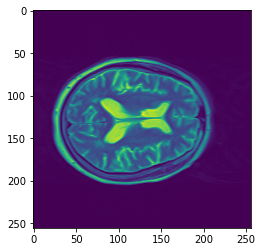

140


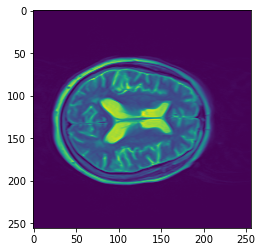

141


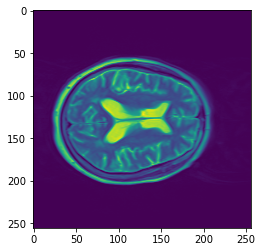

142


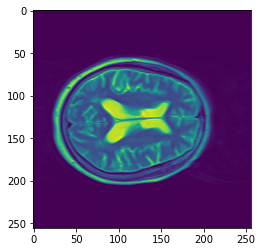

143


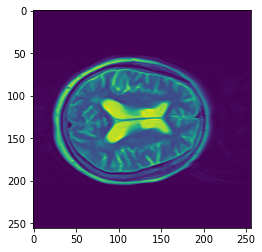

144


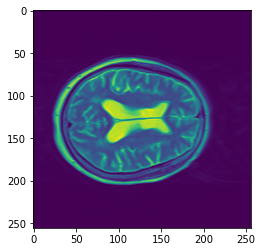

145


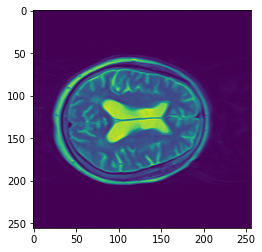

146


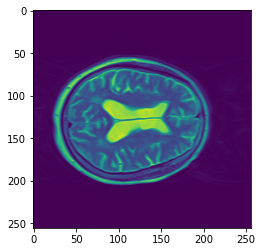

147


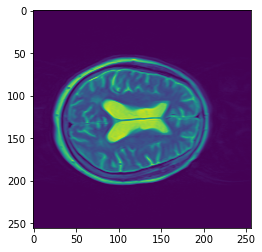

148


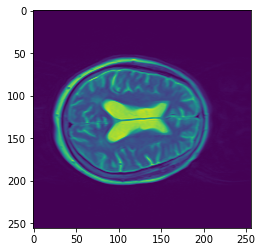

149


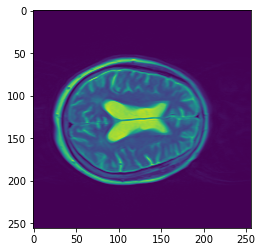

150


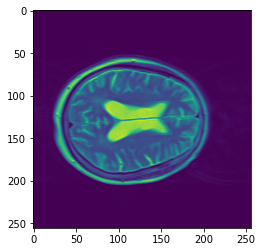

151


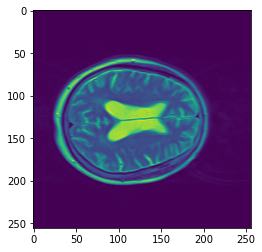

152


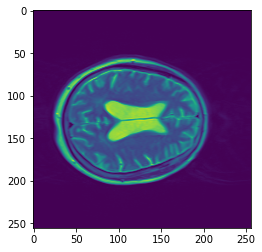

153


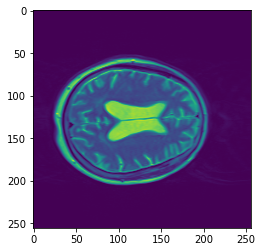

154


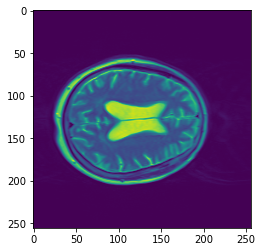

155


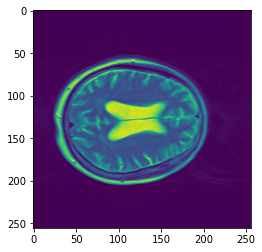

156


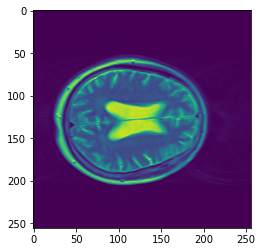

157


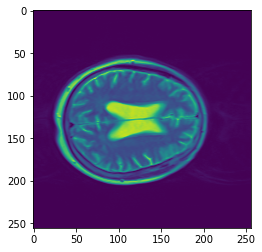

158


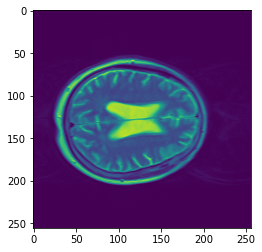

159


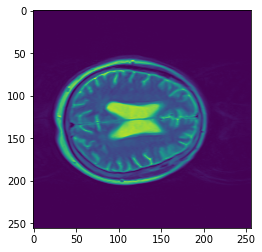

160


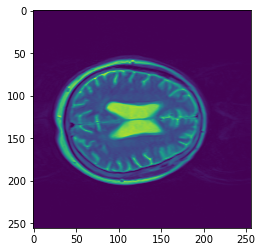

161


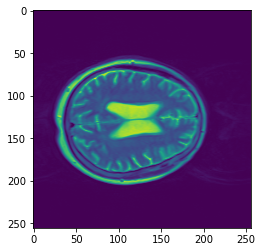

162


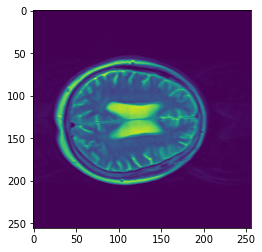

163


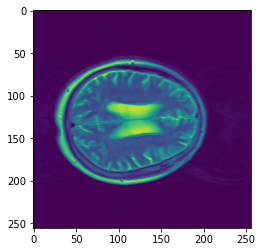

164


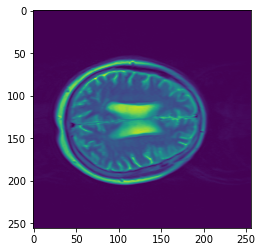

165


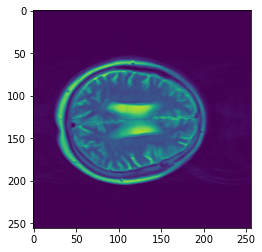

166


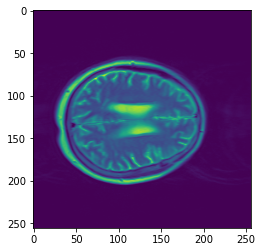

167


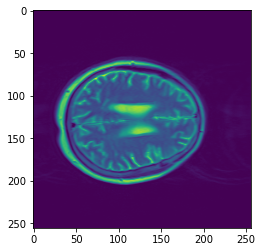

168


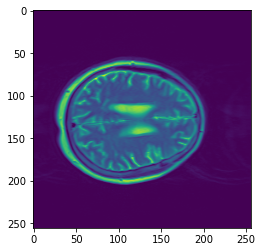

169


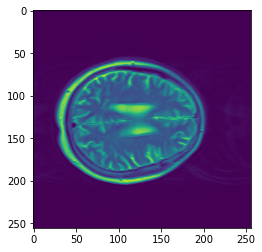

In [249]:
for i in range(130, 170):
    print(i)
    plt.imshow(saveThis3[:,:,i])
    plt.show()

In [264]:
saveAD = []
    
for i in range(140, 160):
    saveAD.append(saveThis3[:,:,i])

In [265]:
crop_saveAD = []
for i in range(len(saveAD)):
    crop_saveAD.append(crop_img(saveAD[i]))

In [266]:
len(crop_saveAD)

20

In [253]:
crop_saveAD[0].shape

(128, 128, 1)

In [268]:
np.save(r'C:\Users\Ch1ck\Desktop\adValidation', crop_saveAD)

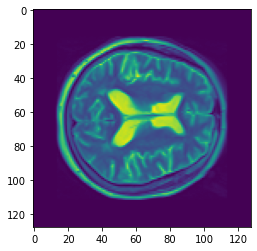

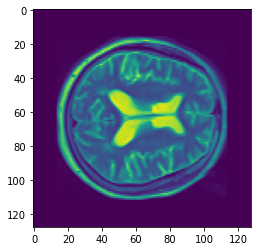

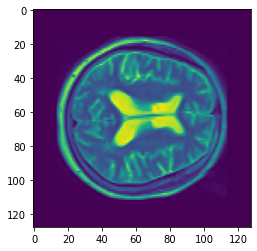

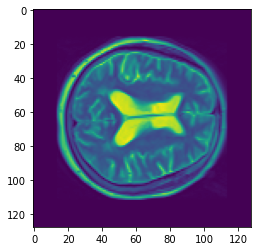

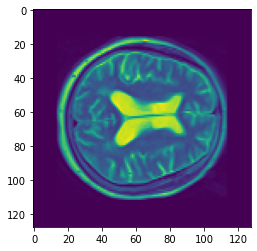

...

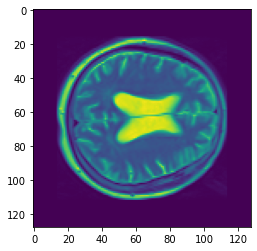

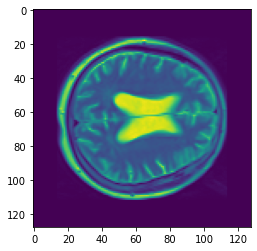

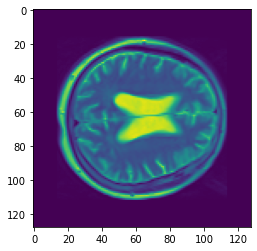

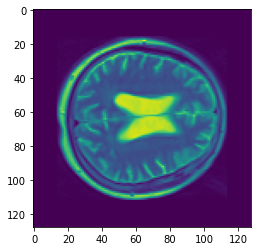

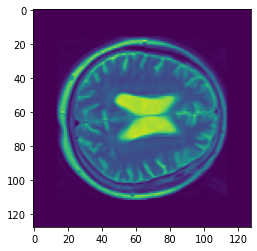

In [267]:
for i in range(len(crop_saveAD)):
    plt.imshow(crop_saveAD[i])
    plt.show()

In [12]:
test = np.array(nib.load(r'C:\Users\Ch1ck\Desktop\490Proj\hi.nii').dataobj)

In [13]:
test = resize_img(test)

In [15]:
def process_img(img):
    slices = []
    for i in range(140,160):
        slices.append(crop_img(img[:,:,i]))
        
    return slices

In [16]:
test = process_img(test)

In [25]:
test = np.array(test)

In [27]:
test.shape

(20, 128, 128, 1)